<a href="https://colab.research.google.com/github/kfahn22/computer-vision-course/blob/synthetic-data-creation-lung-images/Synthetic_Date_Creation_lung_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Using DCGAN to Generate Synthetic Lung Images

* DCGAN was proposed in [Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks](https://arxiv.org/abs/1511.06434) by Radford, et al.

* This demo notebook has been adapted from [here](https://github.com/ovh/ai-training-examples/tree/main/notebooks/computer-vision/image-generation/miniconda/dcgan-image-generation).  Apache 2.0 License

## Download the Dataset

* We will be downloading the [Chest X-Ray Images (Pneumonia)](https://www.kaggle.com/datasets/paultimothymooney/chest-xray-pneumonia) dataset from [Kaggle](https://www.kaggle.com).

### From the Data Card:

* The dataset is organized into 3 folders (train, test, val) and contains subfolders for each image category (Pneumonia/Normal). There are 5,863 X-Ray images (JPEG) and 2 categories (Pneumonia/Normal).

* Chest X-ray images (anterior-posterior) were selected from retrospective cohorts of pediatric patients of one to five years old from Guangzhou Women and Children’s Medical Center, Guangzhou. All chest X-ray imaging was performed as part of patients’ routine clinical care.

* For the analysis of chest x-ray images, all chest radiographs were initially screened for quality control by removing all low quality or unreadable scans. The diagnoses for the images were then graded by two expert physicians before being cleared for training the AI system. In order to account for any grading errors, the evaluation set was also checked by a third expert.



In [ ]:
# Optional - run this if you would like to save the downloaded dataset in Google Drive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Install the dependencies

In [ ]:
!pip install -q kaggle torch torchvision

## Steps to download a dataset from Kaggle:

1.   You must create a Kaggle account (if you do not already have one).
2.   Click on Settings
3.   Under API, click Create New Token
4.   Upload the kaggle.json file

## More information on how to download a dataset from Kaggle:

* [How to use/download kaggle datasets in Google Colab](https://www.kaggle.com/discussions/general/371462#2060661)

* [Steps to download Kaggle datasets in Google Colab](https://www.kaggle.com/discussions/general/156610)


In [ ]:
from google.colab import files

files.upload() #this will prompt you to upload the kaggle.json

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"kathymcguiness","key":"c4c64a553eec93c2d587ae74dc9f3474"}'}

In [ ]:
ls -lha kaggle.json

-rw-r--r-- 1 root root 70 Dec  2 14:18 kaggle.json


## Kaggle expects the kaggle.json file to be in ~/.kaggle/kaggle.json, so we will move the file there.

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

 ## Permissions

 * This next cell is optional.

 * It sets the permissions of the kaggle.json file to be readable and writable only by the file owner (root user), with no permissions for others. This is a security measure to ensure that only the root user can read or modify the contents of this file.

In [ ]:
!chmod 600 /root/.kaggle/kaggle.json

## Download the dataset

In [ ]:
!kaggle datasets download -d paultimothymooney/chest-xray-pneumonia

100% 2.29G/2.29G [01:23<00:00, 29.7MB/s]
100% 2.29G/2.29G [01:23<00:00, 29.4MB/s]


## Transfer the zip file to Google Drive, if desired

In [ ]:
# Optional code to transfer dataset to Google Drive

#!cp /content/chest-xray-pneumonia.zip /content/gdrive/MyDrive
!cp /content/gdrive/MyDrive/chest-xray-pneumonia.zip /content/chest-xray-pneumonia.zip # run this to transfer set back

## Unzip the dataset

In [ ]:
import zipfile

# Unzip the dataset
path_to_zip_file = "chest-xray-pneumonia.zip"
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall("chest-xray-pneumonia")


## We are going to start by visualizing the images

First, let's load the image paths.

In [ ]:
from imutils import paths

normal_images_paths = list(paths.list_images("/content/chest-xray-pneumonia/chest_xray/train/NORMAL"))
pneumonia_images_paths = list(paths.list_images("/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA"))

normal_images_paths[:5], pneumonia_images_paths[:5]

(['/content/chest-xray-pneumonia/chest_xray/train/NORMAL/NORMAL2-IM-1126-0001.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/NORMAL/IM-0564-0001.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/NORMAL/NORMAL2-IM-1025-0001.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/NORMAL/IM-0637-0001.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/NORMAL/NORMAL2-IM-1256-0001.jpeg'],
 ['/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA/person126_virus_255.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA/person1242_virus_2109.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA/person1345_bacteria_3426.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA/person108_virus_200.jpeg',
  '/content/chest-xray-pneumonia/chest_xray/train/PNEUMONIA/person867_virus_1512.jpeg'])

Then we load the images from the paths.

In [ ]:
from PIL import Image
import numpy as np

def load_images(image_paths):
    images = []
    for path in image_paths:
        image = Image.open(path)
        images.append(np.array(image))
    return images

We will use we make use a utility function to plot the loaded images.

In [ ]:
import matplotlib.pyplot as plt

def plot_images(images, title=None):
    plt.figure(figsize=(20, 20))
    for i in range(len(images)):
        ax = plt.subplot(1, len(images), i + 1)
        if title is not None:
            plt.title(title)
        plt.imshow(images[i])
        plt.axis("off")

Let's take a look at some normal lung images.

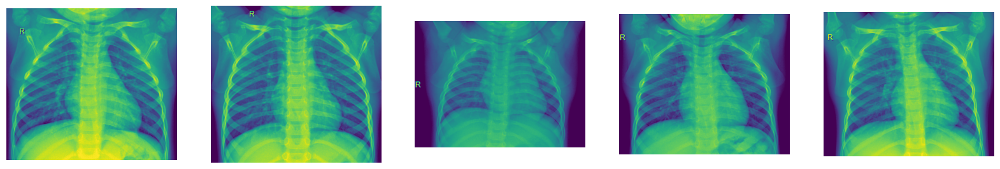

In [ ]:
plot_images(load_images(normal_images_paths[:5]))

And now let's look at lung images that have been labeled as pneumoia.

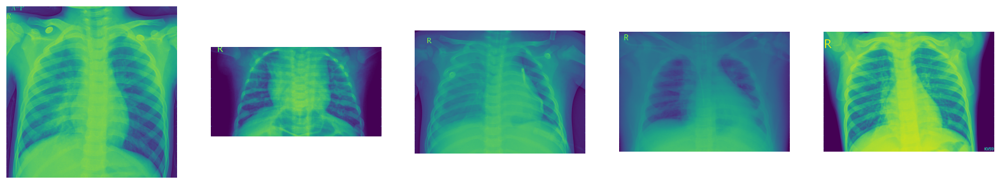

In [ ]:
plot_images(load_images(pneumonia_images_paths[:5]))

As you can see, the images are not a uniform size, so we will need to normalize them.

## Import the necessary libraries

In [ ]:
from IPython.display import HTML
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import math
import numpy as np
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

## We will set a seed so that the generation is reproducable.

In [ ]:
seed = 42
random.seed(seed)
torch.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

## Define the parameters

In [ ]:
# Load 9 images
nb_images = 9
nb_row = math.ceil(math.sqrt(nb_images))


# Define parameters
dataroot = "/content/chest-xray-pneumonia/chest_xray/train"
nb_channels = 3 # For RGB images, but if you use grayscale images, ToTensor() will replicate the single channel into three channels, so you should not have to modify anything
image_resize = 64

batch_size = 128
nb_gpu = 1
nb_workers = 2 # based on system resources

# GPU or CPU (Not having at least 1 GPU can prevent code from working)
device = torch.device("cuda:0" if (torch.cuda.is_available() and nb_gpu > 0) else "cpu")

## Process the dataset

In [ ]:
# Create the dataset by applying transformation to our images
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_resize),
                               transforms.CenterCrop(image_resize),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [ ]:
print(f'Number of downloaded images: {len(dataset)}')

Number of downloaded images: 5216


# Create a dataloader

In [ ]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=nb_workers)

real_batch = next(iter(dataloader))

# Models

First, we us define some parameters.

In [ ]:
# Size of z latent vector (i.e. size of generator input), same size as described in the DCGAN paper
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers, same value as described in the DCGAN paper
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers, same value as described in the DCGAN paper
beta1 = 0.5

The model weights sare randomly initialized from a Normal distribution with mean=0, stdev=0.02.
 These are applied to each layer of Generator and Discriminator.

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Create the Generator

In [ ]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, nb_gpu):
        super(Generator, self).__init__()
        self.nb_gpu = nb_gpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution

            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``

            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``

            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``

            nn.ConvTranspose2d(ngf, nb_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nb_channels) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

## Initialize the Generator

In [ ]:
# Create the generator
netG = Generator(nb_gpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (nb_gpu > 1):
    netG = nn.DataParallel(netG, list(range(nb_gpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Create the Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, nb_gpu):
        super(Discriminator, self).__init__()
        self.nb_gpu = nb_gpu
        self.main = nn.Sequential(
            # input is ``(nb_channels) x 64 x 64``

            nn.Conv2d(nb_channels, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``

            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``

            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(nb_gpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (nb_gpu > 1):
    netD = nn.DataParallel(netD, list(range(nb_gpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## When the discriminator chooses, there are three possible outcomes:

* Correct decision
* Type 1 error (false positive) - false image but discriminator thinks it is real
* Type 2 error (false negative) - real image and discriminator thinks it is fake


In [ ]:
# Real image and discriminator thinks it is real - Right decision
target = 1
output= 0.99

print(-(target * math.log(output) + (1-target)*math.log(1-output)))

# Real image and discriminator thinks it is fake - False decision
target = 1
output= 0.01

print(-(target * math.log(output) + (1-target)*math.log(1-output)))

# False image but discriminator thinks it is real - False decision
target = 0
output= 0.99

print(-(target * math.log(output) + (1-target)*math.log(1-output)))

0.01005033585350145
4.605170185988091
4.605170185988091


## We will use Binary Cross Entropy Loss as our loss function.

* BCELoss measures the difference between the predicted probabilities and the actual target values.



In [ ]:
# Set real and fake label values (following GAN paper convention)
real_label = 1.
fake_label = 0.

# Define loss function
criterion = nn.BCELoss()

## Set up the optimizers

In [ ]:
# Setup optimizers for both G and D, according to the DCGAN paper
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

We initialize with random noise.

In [ ]:
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

## Save the model checkpoints

In [ ]:
# Flags - For each epoch
show_images = True
save_images = True
save_model = True

def save_dcgan(netG, netD, path_checkpoint):
    checkpoint = {"g_model_state_dict": netG.state_dict(),
                "d_model_state_dict": netD.state_dict(),
                }

    torch.save(checkpoint, path_checkpoint)

def makedir(new_dir):
  if not os.path.exists(new_dir):
    os.makedirs(new_dir)

# Create folders
makedir("images")
makedir("models")

## Create the training loop

Epoch: 0/100 Batches: 0/41	Loss_D: 1.3426   Loss_G: 3.1217    D(x): 0.4927    D(G(z)): 0.3128 / 0.0576


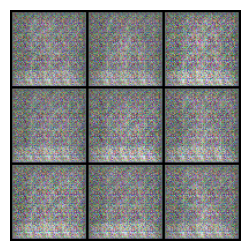

Epoch: 1/100 Batches: 0/41	Loss_D: 1.1274   Loss_G: 29.3920    D(x): 0.6104    D(G(z)): 0.0000 / 0.0000


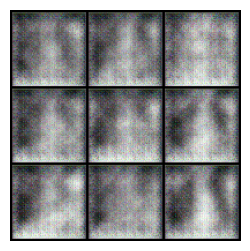

Epoch: 2/100 Batches: 0/41	Loss_D: 0.2399   Loss_G: 5.5082    D(x): 0.9080    D(G(z)): 0.0932 / 0.0084


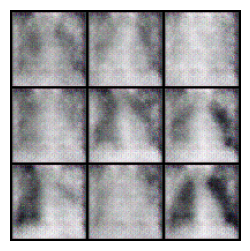

Epoch: 3/100 Batches: 0/41	Loss_D: 0.4955   Loss_G: 10.6227    D(x): 0.6948    D(G(z)): 0.0011 / 0.0001


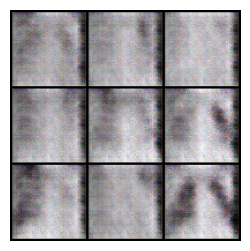

Epoch: 4/100 Batches: 0/41	Loss_D: 0.2406   Loss_G: 5.1662    D(x): 0.9252    D(G(z)): 0.1351 / 0.0085


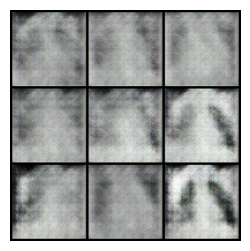

Epoch: 5/100 Batches: 0/41	Loss_D: 0.3562   Loss_G: 4.5686    D(x): 0.8699    D(G(z)): 0.1490 / 0.0195


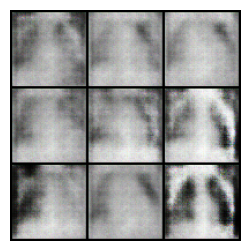

Epoch: 6/100 Batches: 0/41	Loss_D: 0.7014   Loss_G: 4.9042    D(x): 0.8468    D(G(z)): 0.3476 / 0.0273


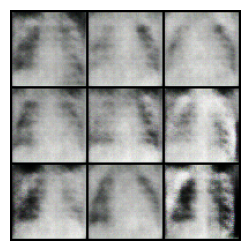

Epoch: 7/100 Batches: 0/41	Loss_D: 0.5107   Loss_G: 2.9950    D(x): 0.7574    D(G(z)): 0.1290 / 0.0961


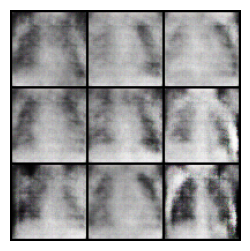

Epoch: 8/100 Batches: 0/41	Loss_D: 0.6122   Loss_G: 3.6090    D(x): 0.6419    D(G(z)): 0.0423 / 0.0519


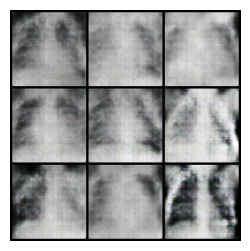

Epoch: 9/100 Batches: 0/41	Loss_D: 0.3064   Loss_G: 4.3065    D(x): 0.8317    D(G(z)): 0.0742 / 0.0289


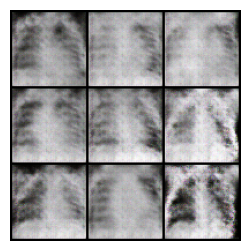

Epoch: 10/100 Batches: 0/41	Loss_D: 0.4756   Loss_G: 3.9014    D(x): 0.7679    D(G(z)): 0.1321 / 0.0444


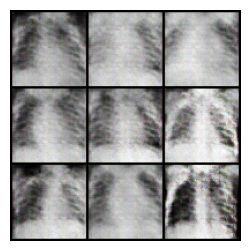

Epoch: 11/100 Batches: 0/41	Loss_D: 0.4147   Loss_G: 3.9655    D(x): 0.8218    D(G(z)): 0.1444 / 0.0439


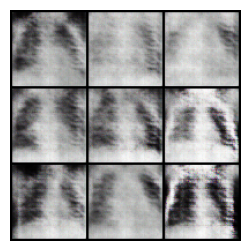

Epoch: 12/100 Batches: 0/41	Loss_D: 1.6434   Loss_G: 10.9824    D(x): 0.9817    D(G(z)): 0.7105 / 0.0087


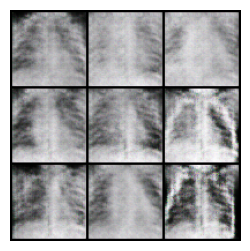

Epoch: 13/100 Batches: 0/41	Loss_D: 0.6495   Loss_G: 6.4559    D(x): 0.9135    D(G(z)): 0.3844 / 0.0042


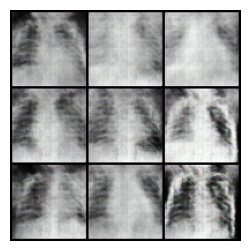

Epoch: 14/100 Batches: 0/41	Loss_D: 0.8662   Loss_G: 2.6712    D(x): 0.5043    D(G(z)): 0.0166 / 0.1135


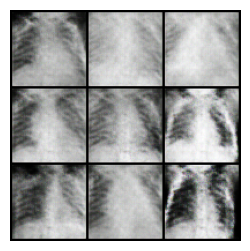

Epoch: 15/100 Batches: 0/41	Loss_D: 0.3986   Loss_G: 5.1204    D(x): 0.8735    D(G(z)): 0.1634 / 0.0118


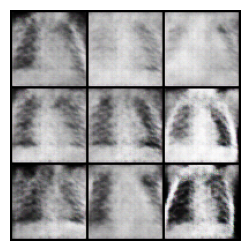

Epoch: 16/100 Batches: 0/41	Loss_D: 0.4638   Loss_G: 5.0265    D(x): 0.9025    D(G(z)): 0.2517 / 0.0280


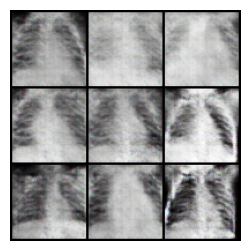

Epoch: 17/100 Batches: 0/41	Loss_D: 0.3665   Loss_G: 3.6319    D(x): 0.7927    D(G(z)): 0.0645 / 0.0504


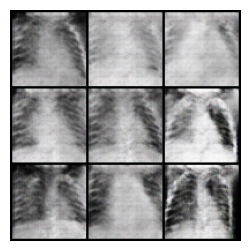

Epoch: 18/100 Batches: 0/41	Loss_D: 0.3467   Loss_G: 6.0447    D(x): 0.7797    D(G(z)): 0.0209 / 0.0102


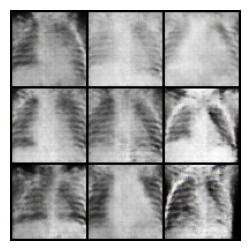

Epoch: 19/100 Batches: 0/41	Loss_D: 0.4372   Loss_G: 3.1446    D(x): 0.7937    D(G(z)): 0.1146 / 0.0707


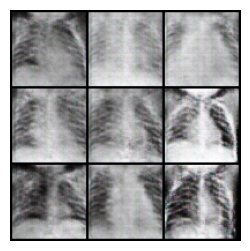

Epoch: 20/100 Batches: 0/41	Loss_D: 0.3865   Loss_G: 4.3926    D(x): 0.8176    D(G(z)): 0.1346 / 0.0284


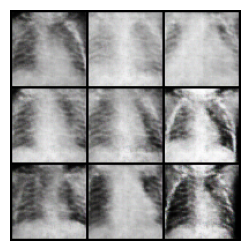

Epoch: 21/100 Batches: 0/41	Loss_D: 0.7010   Loss_G: 6.2975    D(x): 0.9135    D(G(z)): 0.3567 / 0.0225


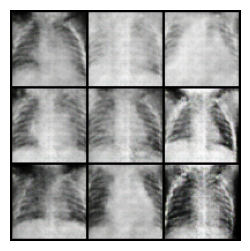

Epoch: 22/100 Batches: 0/41	Loss_D: 0.3340   Loss_G: 5.7796    D(x): 0.9222    D(G(z)): 0.1925 / 0.0104


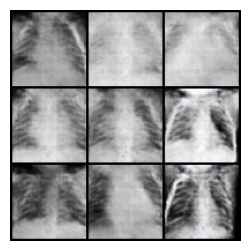

Epoch: 23/100 Batches: 0/41	Loss_D: 0.5313   Loss_G: 6.3377    D(x): 0.8749    D(G(z)): 0.2656 / 0.0117


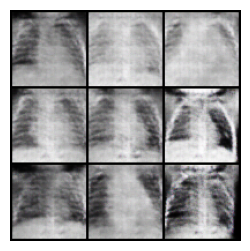

Epoch: 24/100 Batches: 0/41	Loss_D: 0.6639   Loss_G: 7.0542    D(x): 0.9470    D(G(z)): 0.3887 / 0.0045


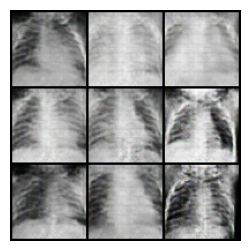

Epoch: 25/100 Batches: 0/41	Loss_D: 0.7214   Loss_G: 3.6568    D(x): 0.6084    D(G(z)): 0.0231 / 0.0617


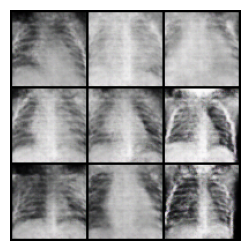

Epoch: 26/100 Batches: 0/41	Loss_D: 0.4302   Loss_G: 5.2839    D(x): 0.9223    D(G(z)): 0.2691 / 0.0119


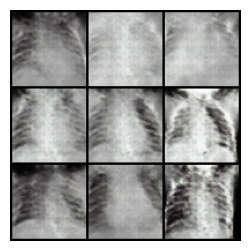

Epoch: 27/100 Batches: 0/41	Loss_D: 0.4110   Loss_G: 4.7063    D(x): 0.8078    D(G(z)): 0.1252 / 0.0241


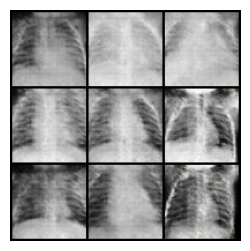

Epoch: 28/100 Batches: 0/41	Loss_D: 0.4112   Loss_G: 5.1704    D(x): 0.8894    D(G(z)): 0.2225 / 0.0142


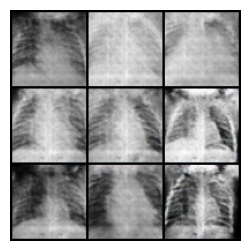

Epoch: 29/100 Batches: 0/41	Loss_D: 0.8297   Loss_G: 3.4729    D(x): 0.5750    D(G(z)): 0.0252 / 0.1174


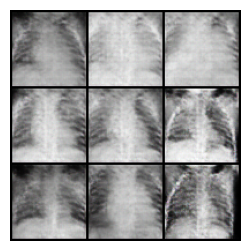

Epoch: 30/100 Batches: 0/41	Loss_D: 0.3227   Loss_G: 4.0237    D(x): 0.7873    D(G(z)): 0.0495 / 0.0314


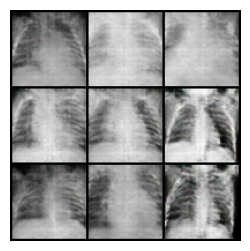

Epoch: 31/100 Batches: 0/41	Loss_D: 0.3919   Loss_G: 4.6149    D(x): 0.8252    D(G(z)): 0.1306 / 0.0260


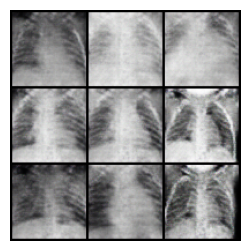

Epoch: 32/100 Batches: 0/41	Loss_D: 0.3756   Loss_G: 6.6073    D(x): 0.9540    D(G(z)): 0.2569 / 0.0026


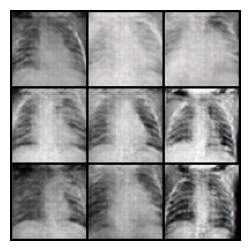

Epoch: 33/100 Batches: 0/41	Loss_D: 0.2028   Loss_G: 5.3127    D(x): 0.9025    D(G(z)): 0.0775 / 0.0307


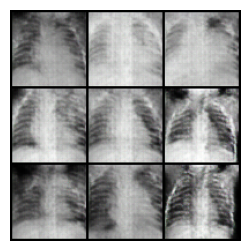

Epoch: 34/100 Batches: 0/41	Loss_D: 0.5352   Loss_G: 6.3043    D(x): 0.8525    D(G(z)): 0.2362 / 0.0105


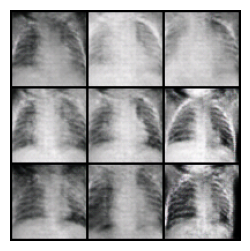

Epoch: 35/100 Batches: 0/41	Loss_D: 0.3145   Loss_G: 4.4095    D(x): 0.8602    D(G(z)): 0.1254 / 0.0277


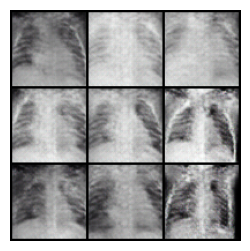

Epoch: 36/100 Batches: 0/41	Loss_D: 0.4948   Loss_G: 4.0114    D(x): 0.7484    D(G(z)): 0.1185 / 0.0370


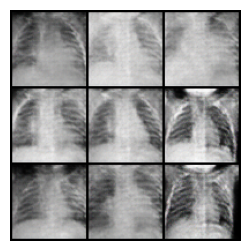

Epoch: 37/100 Batches: 0/41	Loss_D: 0.3817   Loss_G: 6.7235    D(x): 0.9330    D(G(z)): 0.2480 / 0.0042


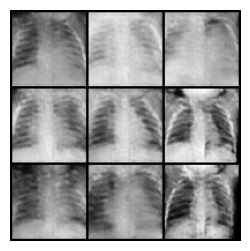

Epoch: 38/100 Batches: 0/41	Loss_D: 0.6843   Loss_G: 8.1652    D(x): 0.9382    D(G(z)): 0.4184 / 0.0031


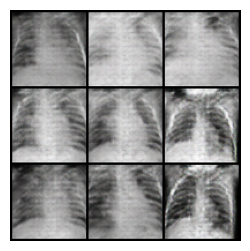

Epoch: 39/100 Batches: 0/41	Loss_D: 0.3670   Loss_G: 5.0358    D(x): 0.7558    D(G(z)): 0.0242 / 0.0169


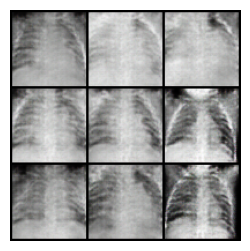

Epoch: 40/100 Batches: 0/41	Loss_D: 0.2829   Loss_G: 4.8982    D(x): 0.8141    D(G(z)): 0.0369 / 0.0302


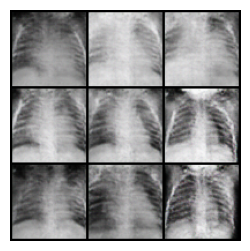

Epoch: 41/100 Batches: 0/41	Loss_D: 0.3107   Loss_G: 4.4428    D(x): 0.8589    D(G(z)): 0.1024 / 0.0225


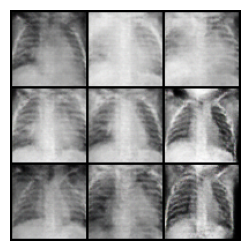

Epoch: 42/100 Batches: 0/41	Loss_D: 0.1942   Loss_G: 4.5782    D(x): 0.9264    D(G(z)): 0.0904 / 0.0192


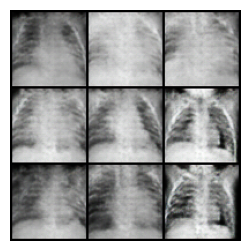

Epoch: 43/100 Batches: 0/41	Loss_D: 0.4478   Loss_G: 7.9315    D(x): 0.9603    D(G(z)): 0.2736 / 0.0021


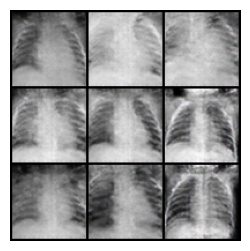

Epoch: 44/100 Batches: 0/41	Loss_D: 0.4329   Loss_G: 7.2876    D(x): 0.9465    D(G(z)): 0.2391 / 0.0023


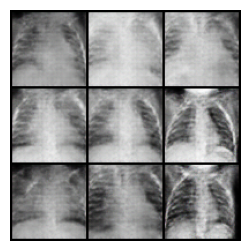

Epoch: 45/100 Batches: 0/41	Loss_D: 0.3942   Loss_G: 7.1550    D(x): 0.9222    D(G(z)): 0.2486 / 0.0032


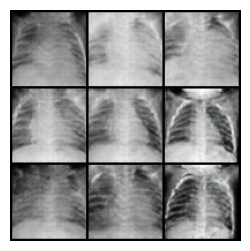

Epoch: 46/100 Batches: 0/41	Loss_D: 0.4697   Loss_G: 6.4994    D(x): 0.9129    D(G(z)): 0.2698 / 0.0036


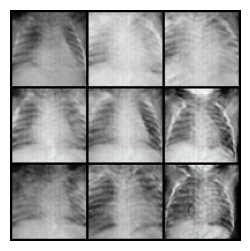

Epoch: 47/100 Batches: 0/41	Loss_D: 0.4110   Loss_G: 7.8885    D(x): 0.9306    D(G(z)): 0.2607 / 0.0028


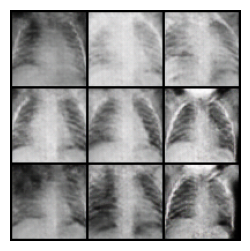

Epoch: 48/100 Batches: 0/41	Loss_D: 0.3046   Loss_G: 4.6377    D(x): 0.7961    D(G(z)): 0.0219 / 0.0496


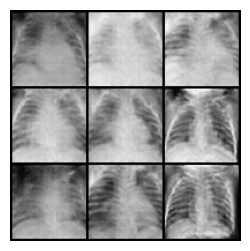

Epoch: 49/100 Batches: 0/41	Loss_D: 0.2433   Loss_G: 6.4444    D(x): 0.9480    D(G(z)): 0.1506 / 0.0030


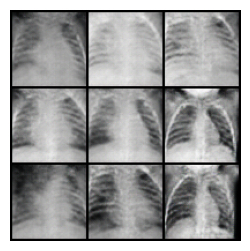

Epoch: 50/100 Batches: 0/41	Loss_D: 0.3734   Loss_G: 3.7371    D(x): 0.9351    D(G(z)): 0.1955 / 0.0588


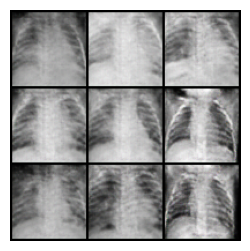

Epoch: 51/100 Batches: 0/41	Loss_D: 0.2898   Loss_G: 4.1492    D(x): 0.8197    D(G(z)): 0.0369 / 0.0293


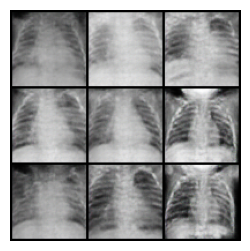

Epoch: 52/100 Batches: 0/41	Loss_D: 0.1944   Loss_G: 2.9617    D(x): 0.9393    D(G(z)): 0.1043 / 0.0999


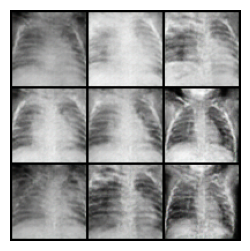

Epoch: 53/100 Batches: 0/41	Loss_D: 0.2452   Loss_G: 5.5019    D(x): 0.9832    D(G(z)): 0.1819 / 0.0091


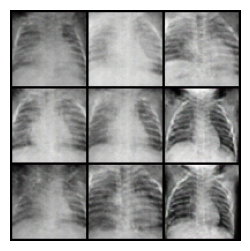

Epoch: 54/100 Batches: 0/41	Loss_D: 0.3188   Loss_G: 5.0670    D(x): 0.8110    D(G(z)): 0.0355 / 0.0165


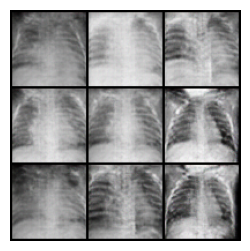

Epoch: 55/100 Batches: 0/41	Loss_D: 0.1382   Loss_G: 4.7271    D(x): 0.9510    D(G(z)): 0.0772 / 0.0182


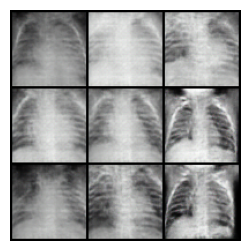

Epoch: 56/100 Batches: 0/41	Loss_D: 0.4501   Loss_G: 7.5897    D(x): 0.9568    D(G(z)): 0.2889 / 0.0044


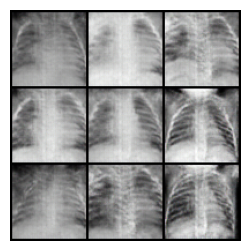

Epoch: 57/100 Batches: 0/41	Loss_D: 0.3220   Loss_G: 5.9733    D(x): 0.9226    D(G(z)): 0.1887 / 0.0052


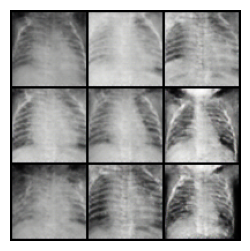

Epoch: 58/100 Batches: 0/41	Loss_D: 0.2637   Loss_G: 5.3997    D(x): 0.8989    D(G(z)): 0.1127 / 0.0190


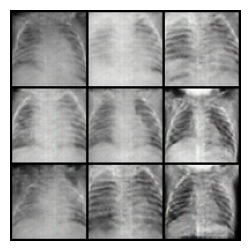

Epoch: 59/100 Batches: 0/41	Loss_D: 0.2219   Loss_G: 4.3098    D(x): 0.8899    D(G(z)): 0.0759 / 0.0288


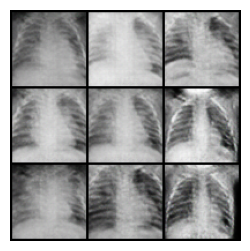

Epoch: 60/100 Batches: 0/41	Loss_D: 0.6246   Loss_G: 3.1395    D(x): 0.6605    D(G(z)): 0.0299 / 0.0758


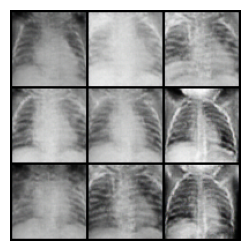

Epoch: 61/100 Batches: 0/41	Loss_D: 0.4715   Loss_G: 2.7814    D(x): 0.7132    D(G(z)): 0.0242 / 0.1075


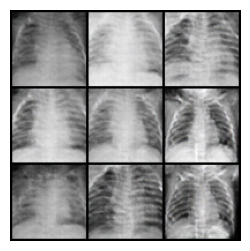

Epoch: 62/100 Batches: 0/41	Loss_D: 0.1563   Loss_G: 4.4074    D(x): 0.9124    D(G(z)): 0.0499 / 0.0190


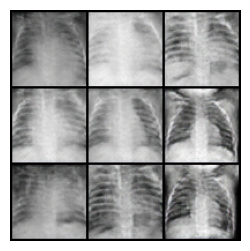

Epoch: 63/100 Batches: 0/41	Loss_D: 0.3700   Loss_G: 5.4150    D(x): 0.9284    D(G(z)): 0.2116 / 0.0114


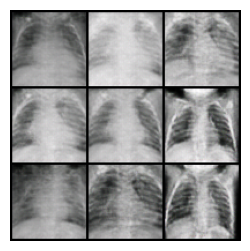

Epoch: 64/100 Batches: 0/41	Loss_D: 0.1696   Loss_G: 5.1142    D(x): 0.8945    D(G(z)): 0.0357 / 0.0118


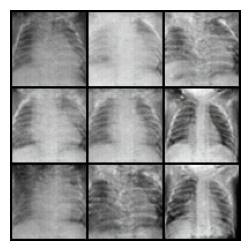

Epoch: 65/100 Batches: 0/41	Loss_D: 0.3282   Loss_G: 6.4842    D(x): 0.9302    D(G(z)): 0.2024 / 0.0032


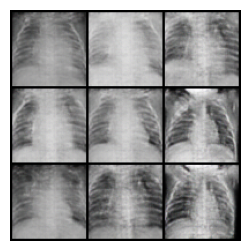

Epoch: 66/100 Batches: 0/41	Loss_D: 0.3457   Loss_G: 5.7557    D(x): 0.9530    D(G(z)): 0.2211 / 0.0064


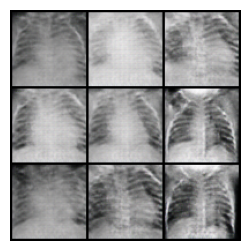

Epoch: 67/100 Batches: 0/41	Loss_D: 0.3016   Loss_G: 5.0881    D(x): 0.8042    D(G(z)): 0.0345 / 0.0136


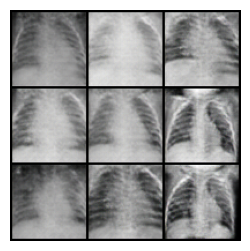

Epoch: 68/100 Batches: 0/41	Loss_D: 0.3010   Loss_G: 6.0819    D(x): 0.9903    D(G(z)): 0.2203 / 0.0046


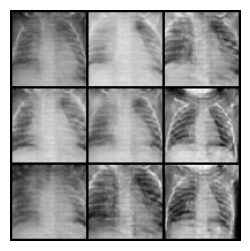

Epoch: 69/100 Batches: 0/41	Loss_D: 0.1370   Loss_G: 4.5639    D(x): 0.9140    D(G(z)): 0.0272 / 0.0189


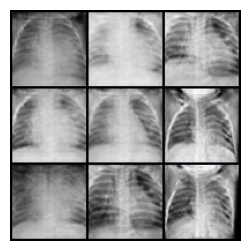

Epoch: 70/100 Batches: 0/41	Loss_D: 0.2572   Loss_G: 4.5559    D(x): 0.9099    D(G(z)): 0.1284 / 0.0207


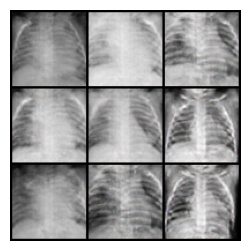

Epoch: 71/100 Batches: 0/41	Loss_D: 0.2232   Loss_G: 5.1398    D(x): 0.9316    D(G(z)): 0.1239 / 0.0093


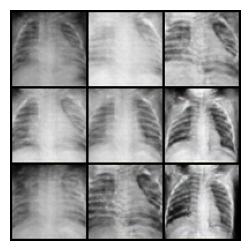

Epoch: 72/100 Batches: 0/41	Loss_D: 0.1885   Loss_G: 4.2027    D(x): 0.9288    D(G(z)): 0.0969 / 0.0259


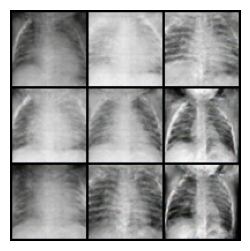

Epoch: 73/100 Batches: 0/41	Loss_D: 0.1931   Loss_G: 5.0568    D(x): 0.9729    D(G(z)): 0.1134 / 0.0582


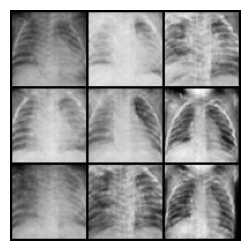

Epoch: 74/100 Batches: 0/41	Loss_D: 0.1822   Loss_G: 5.9768    D(x): 0.9039    D(G(z)): 0.0557 / 0.0085


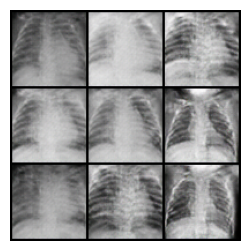

Epoch: 75/100 Batches: 0/41	Loss_D: 0.1823   Loss_G: 4.0172    D(x): 0.9669    D(G(z)): 0.1185 / 0.0307


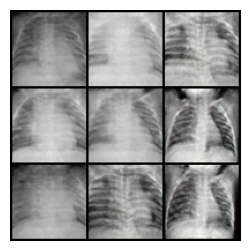

Epoch: 76/100 Batches: 0/41	Loss_D: 0.6890   Loss_G: 10.2354    D(x): 0.9737    D(G(z)): 0.3773 / 0.0022


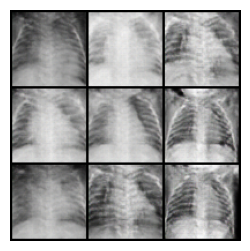

Epoch: 77/100 Batches: 0/41	Loss_D: 0.1530   Loss_G: 4.5978    D(x): 0.9345    D(G(z)): 0.0727 / 0.0204


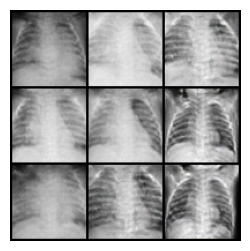

Epoch: 78/100 Batches: 0/41	Loss_D: 0.2094   Loss_G: 5.0548    D(x): 0.9447    D(G(z)): 0.1289 / 0.0095


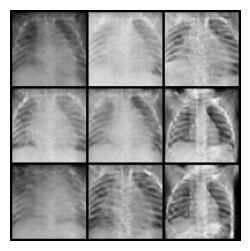

Epoch: 79/100 Batches: 0/41	Loss_D: 0.2685   Loss_G: 5.6089    D(x): 0.9930    D(G(z)): 0.1952 / 0.0084


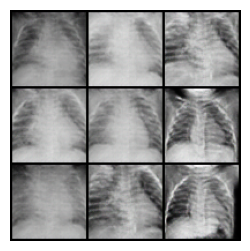

Epoch: 80/100 Batches: 0/41	Loss_D: 0.1630   Loss_G: 3.9480    D(x): 0.9092    D(G(z)): 0.0533 / 0.0372


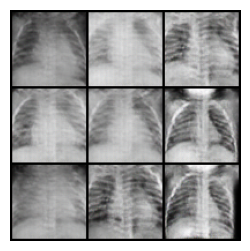

Epoch: 81/100 Batches: 0/41	Loss_D: 0.5870   Loss_G: 4.4362    D(x): 0.6909    D(G(z)): 0.0146 / 0.0485


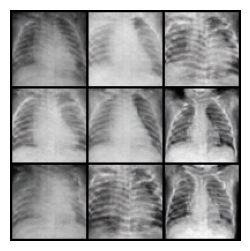

Epoch: 82/100 Batches: 0/41	Loss_D: 0.8255   Loss_G: 3.8807    D(x): 0.6334    D(G(z)): 0.0093 / 0.0634


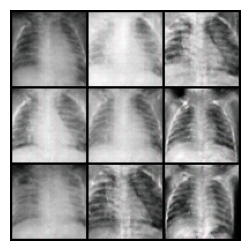

Epoch: 83/100 Batches: 0/41	Loss_D: 0.0773   Loss_G: 6.6026    D(x): 0.9594    D(G(z)): 0.0233 / 0.0041


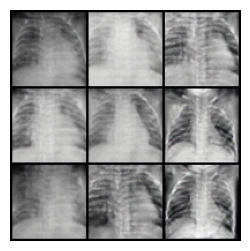

Epoch: 84/100 Batches: 0/41	Loss_D: 0.1565   Loss_G: 4.9384    D(x): 0.9347    D(G(z)): 0.0769 / 0.0123


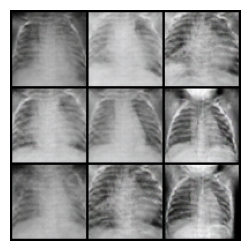

Epoch: 85/100 Batches: 0/41	Loss_D: 0.1823   Loss_G: 3.9891    D(x): 0.8838    D(G(z)): 0.0364 / 0.0287


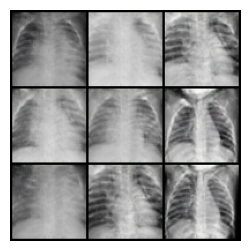

Epoch: 86/100 Batches: 0/41	Loss_D: 0.1567   Loss_G: 4.7571    D(x): 0.9271    D(G(z)): 0.0651 / 0.0158


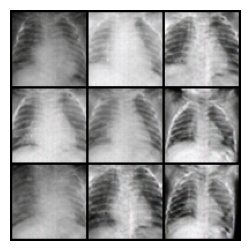

Epoch: 87/100 Batches: 0/41	Loss_D: 0.4708   Loss_G: 11.3894    D(x): 0.9792    D(G(z)): 0.3142 / 0.0001


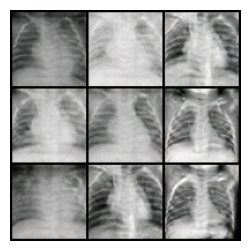

Epoch: 88/100 Batches: 0/41	Loss_D: 0.1195   Loss_G: 4.5138    D(x): 0.9428    D(G(z)): 0.0486 / 0.0180


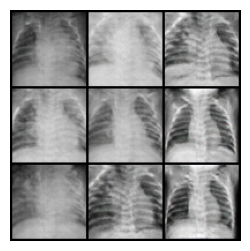

Epoch: 89/100 Batches: 0/41	Loss_D: 0.1357   Loss_G: 4.5060    D(x): 0.9250    D(G(z)): 0.0432 / 0.0166


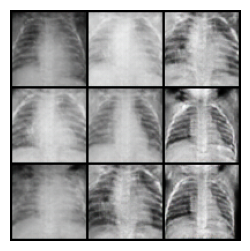

Epoch: 90/100 Batches: 0/41	Loss_D: 0.4118   Loss_G: 8.1359    D(x): 0.9778    D(G(z)): 0.2843 / 0.0010


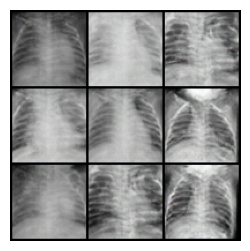

Epoch: 91/100 Batches: 0/41	Loss_D: 0.1971   Loss_G: 5.0753    D(x): 0.9698    D(G(z)): 0.1385 / 0.0092


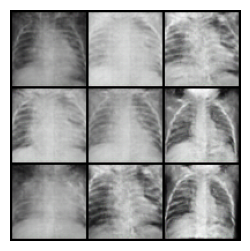

Epoch: 92/100 Batches: 0/41	Loss_D: 0.2086   Loss_G: 5.6854    D(x): 0.9408    D(G(z)): 0.0952 / 0.0060


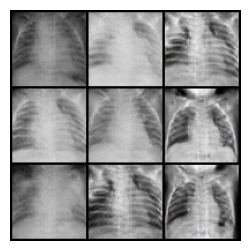

Epoch: 93/100 Batches: 0/41	Loss_D: 0.4273   Loss_G: 8.2605    D(x): 0.9842    D(G(z)): 0.2867 / 0.0019


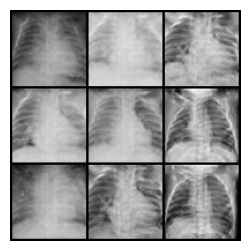

Epoch: 94/100 Batches: 0/41	Loss_D: 0.0752   Loss_G: 4.9320    D(x): 0.9606    D(G(z)): 0.0298 / 0.0162


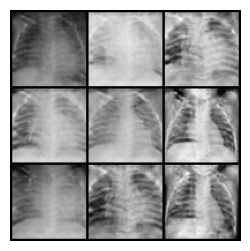

Epoch: 95/100 Batches: 0/41	Loss_D: 0.2208   Loss_G: 5.2973    D(x): 0.9849    D(G(z)): 0.1534 / 0.0118


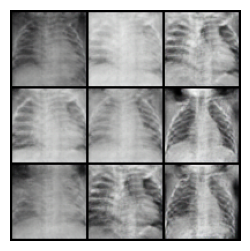

Epoch: 96/100 Batches: 0/41	Loss_D: 0.3913   Loss_G: 4.6508    D(x): 0.7519    D(G(z)): 0.0099 / 0.0243


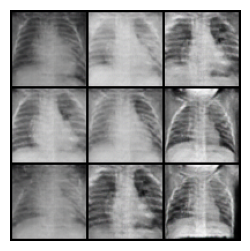

Epoch: 97/100 Batches: 0/41	Loss_D: 0.1365   Loss_G: 4.6213    D(x): 0.9508    D(G(z)): 0.0745 / 0.0173


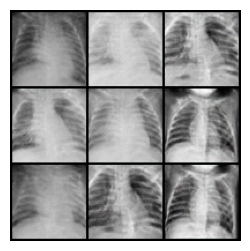

Epoch: 98/100 Batches: 0/41	Loss_D: 0.0997   Loss_G: 5.2459    D(x): 0.9509    D(G(z)): 0.0409 / 0.0097


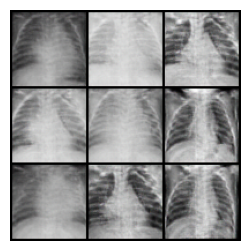

Epoch: 99/100 Batches: 0/41	Loss_D: 0.1377   Loss_G: 4.4398    D(x): 0.9047    D(G(z)): 0.0195 / 0.0189


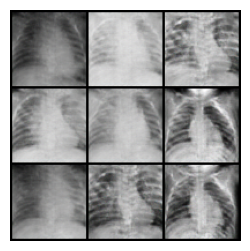

In [ ]:

# Training Loop
data_len = len(dataloader)

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []


# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader (depends on batch_size and your number of images)
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        ############################
        # (3) Metrics & Evaluation
        ###########################

        # Print output training stats every 50 batches (if your dataset is large, printing at every epoch might be less frequent than you want)
        if i % 50 == 0:
            print(f"Epoch: {epoch}/{num_epochs} Batches: {i}/{data_len}\tLoss_D: {errD.item():.4f}   Loss_G: {errG.item():.4f}    D(x): {D_x:.4f}    D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}")

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

    # Generate fake images to see how the generator is doing by saving G's output on fixed_noise at each epoch (fixed noise allow to obtain similar images).
    if show_images == True:
        with torch.no_grad():
            # Uncomment the line below to generate a new variety of images every time
            #fixed_noise = torch.randn(64, nz, 1, 1, device=device)

            fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake[:nb_images], padding=2, normalize=True, nrow=nb_row))

            plt.figure(figsize=(3, 3))
            plt.axis("off")
            plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))

            if save_images == True:
                plt.savefig(f'images/epoch_{epoch}_gen_images.png')

            # Display image
            plt.show()

    # Save models each 5 epochs
    if epoch % 5 == 0:
        if save_model:
            save_dcgan(netG, netD, path_checkpoint=f"models/chest_epoch_{epoch}_checkpoint.pkl")

# Save the final models
save_dcgan(netG, netD, path_checkpoint="models/chest_final_epoch_checkpoint.pkl")

## Plot losses

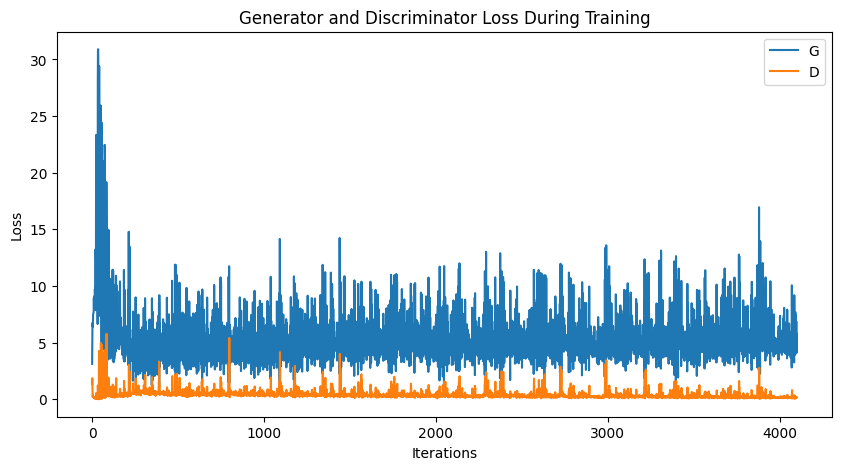

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
# increase the default limit set by Matplotlib for embedding animations
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100  # 100 MB

## Follow the training

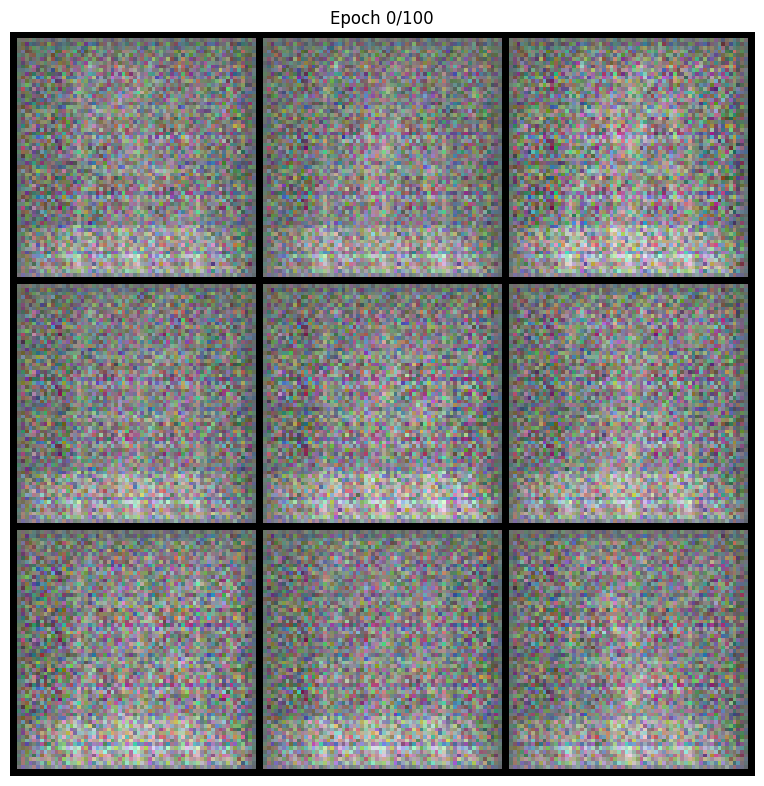

In [ ]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
plt.tight_layout(pad=2.0, h_pad=2.0, w_pad=2.0)

# Initial empty title and image
title = plt.title("")
img_plot = plt.imshow(np.transpose(img_list[0], (1, 2, 0)), animated=True)

def update_title_and_image(frame):
    img_plot.set_array(np.transpose(img_list[frame], (1, 2, 0)))
    title.set_text(f"Epoch {frame}/{num_epochs}")

ani = animation.FuncAnimation(fig, update_title_and_image, frames=len(img_list), interval=100, repeat_delay=5000)

# Display animation
HTML(ani.to_jshtml())

In [27]:
# Save the animation as a GIF
ani.save('images/dcgan_training_animation.gif', writer='pillow')

## Inference

In [28]:
# Specify desired weights path
path_checkpoint = "models/chest_final_epoch_checkpoint.pkl"

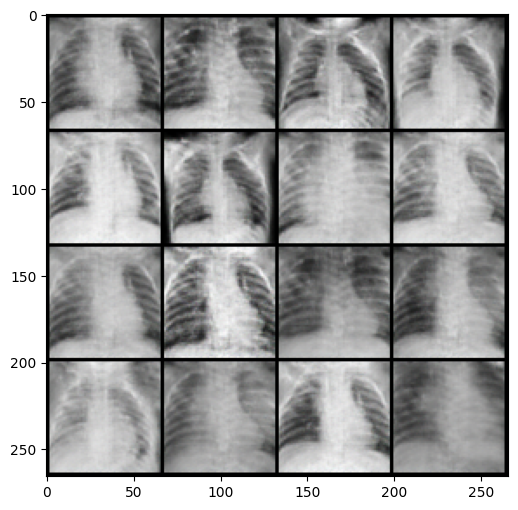

In [30]:
# Number of desired images
num_img = 16
nb_row = math.ceil(math.sqrt(num_img))

# Create a random noise
random_noise = torch.randn(num_img, nz, 1, 1, device=device)

# Instantiate a generator
new_gen= Generator(nb_gpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (nb_gpu > 1):
    new_gen = nn.DataParallel(new_gen, list(range(nb_gpu)))

# Load weights from path
checkpoint = torch.load(path_checkpoint, map_location="cpu")
state_dict_g = checkpoint["g_model_state_dict"]
new_gen.load_state_dict(state_dict_g)

# Generate images
with torch.no_grad():
    fake_data = new_gen(random_noise).detach().cpu()

# Plot images
img_grid = vutils.make_grid(fake_data, padding=2, normalize=True, nrow=nb_row).cpu()
img_grid = np.transpose(img_grid, (1, 2, 0))
plt.figure(figsize=(6, 6))
plt.imshow(img_grid)
plt.show()

## Post Processing

In [31]:
# Instantiate a discriminator
new_dis= Discriminator(nb_gpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (nb_gpu > 1):
    new_dis = nn.DataParallel(new_dis, list(range(nb_gpu)))

# Load weights from path
checkpoint = torch.load(path_checkpoint, map_location="cpu")
state_dict_d = checkpoint["d_model_state_dict"]
new_dis.load_state_dict(state_dict_d)

<All keys matched successfully>

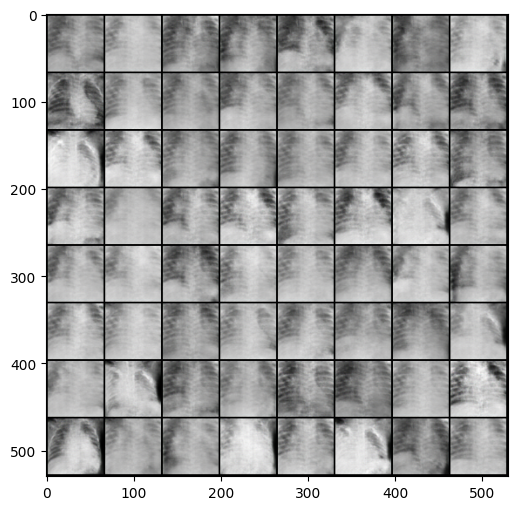

In [33]:
# Set threshold
threshold = 0.70


# Create list to store the images classified as >= threshold
verified_images = []

# Till we do not have 64 images

while len(verified_images)<64:
    # Create a random noise
    random_noise = torch.randn(num_img, nz, 1, 1, device=device)
    # Generate images for this noise
    with torch.no_grad():
        fake_data = new_gen(random_noise)

        # Set the discriminator to eval mode
        new_dis.eval()

        # Pass the generated fake_data through the discriminator & obtain real/fake probabilities
        output_probabilities = new_dis(fake_data)

    # Create mask (If prob < threshold, set to False, else True)
    good_image_mask = output_probabilities >= threshold

    # Remove extra tensor dims (torch.Size([16, 1, 1, 1]) -> torch.Size([16]))
    good_image_mask = good_image_mask.squeeze()

    # Keep the selected images
    good_images = fake_data[good_image_mask > threshold]

    # If good_images is not None
    if good_images.numel() > 0:
        # Loop through the tensor along the first dimension (index 0), since we have x images in a torch.Size([x, 3, 64, 64]) object
        for i in range(good_images.size(0)):
            # Add selected images
            verified_images.append(good_images[i])

# Plot selected images
img_grid = vutils.make_grid(verified_images, padding=2, normalize=True, nrow=8).cpu()
img_grid = np.transpose(img_grid, (1, 2, 0))
plt.figure(figsize=(6, 6))
plt.imshow(img_grid)
plt.show()

## Curated Images

In [34]:
filtered_images =[]

In [35]:
index_to_keep=[13]

for i in index_to_keep:
    filtered_images.append(verified_images[i])

print(f'Number of curated images {len(filtered_images)}')

Number of curated images 1


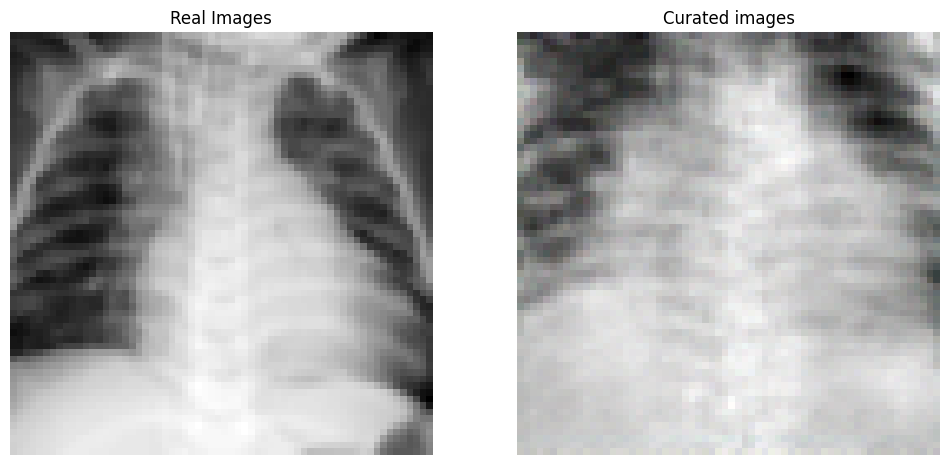

In [36]:
# Plot real training images and our curated images
nb_row = math.ceil(math.sqrt(len(filtered_images)))

# Real images
plt.figure(figsize=(12,12))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:len(filtered_images)], padding=2, normalize=True, nrow=nb_row).cpu(),(1,2,0)))

# Fake images
img_grid = vutils.make_grid(filtered_images, padding=2, normalize=True, nrow=nb_row).cpu()
img_grid = np.transpose(img_grid, (1, 2, 0))
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Curated images")
plt.imshow(img_grid)

plt.show()


# Model Hosting
To host the model, we will use [Hugging Face Hub](https://huggingface.co/). It follows an authentication with token so we need to get our write token from [this page](https://huggingface.co/settings/tokens) and we will use `notebook_login()` to pass the token. Hosting the model using utils from Hugging Face Hub enables better versioning of models with reproducibility tools, e.g. model cards, and also easy loading without storing the model locally.